In [1]:
from tensorflow.keras.models import Model
import tensorflow.keras.backend as K
import tensorflow as tf 
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np

In c:\programdata\miniconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The text.latex.preview rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In c:\programdata\miniconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The mathtext.fallback_to_cm rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In c:\programdata\miniconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: Support for setting the 'mathtext.fallback_to_cm' rcParam is deprecated since 3.3 and will be removed two minor releases later; use 'mathtext.fallback : 'cm' instead.
In c:\programdata\miniconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The validate_bool_maybe_none function was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In c:\programdata\miniconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_tes

In [2]:
inception = tf.keras.applications.InceptionV3(include_top=False, weights='imagenet')


input = inception.input
outputs = [layer.output for layer in inception.layers]
output = [outputs[100], outputs[164]]

model = Model(input, output)

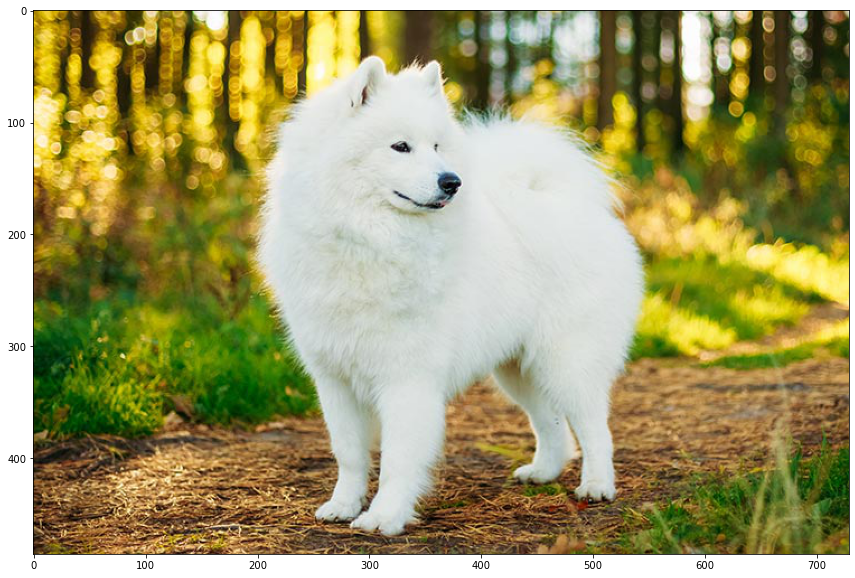

In [3]:
def plot_img(image : np.ndarray, title : str = "",) :
    # make sure we have an image of the right size
    if len(image.shape) == 3 : img = image
    else : img = image[0, :, :, :]

    plt.figure(figsize = (15, 10))
    plt.title(title)
    plt.imshow(img)
    plt.show()
    
def get_grad(img, model) : 
    with tf.GradientTape() as tape : 
        tape.watch(img)
        
        # there may be more than one output layers
        preds = model(img)        

        losses = tf.concat([ [K.mean(pred)] for pred in preds], axis = 0)        
        tot_loss = K.sum(losses)
        
    grad = tape.gradient(tot_loss, img)
    
    grad /= K.std(grad) + 1e-8 
    
    return grad

   
def deep_dream(img, nb_iterations : int, plot_every : int, model, lr : float = 1,) : 
    # img : tensor
    for k in range(nb_iterations) :
        grad = get_grad(img, model)        
        img += lr * grad
        
        img = tf.clip_by_value(img, 0, 1)
        if k % plot_every == 0: 
            print("iteration", k)
            plot_img(img.numpy())
    
    return img

# path to the image, either png or jpeg
PATH = "luffy.jpg"

if "png" not in PATH : new_image = mpimg.imread(PATH)
else : new_image = mpimg.imread(PATH)[:, :, : 3]
    
plot_img(new_image,)

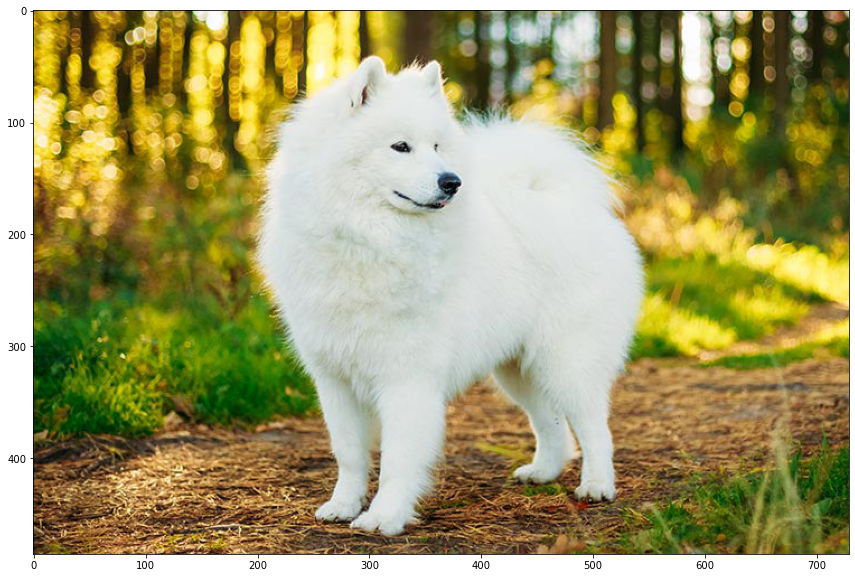

iteration 0


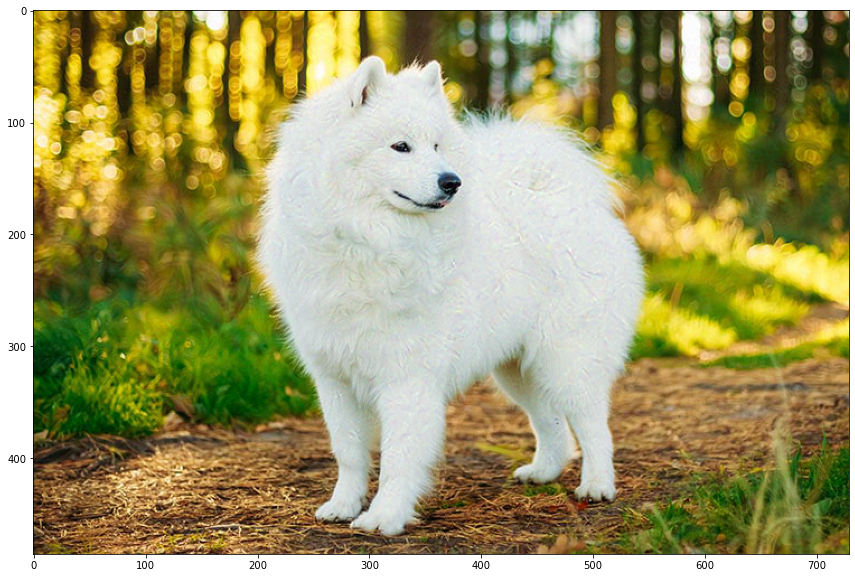

iteration 10


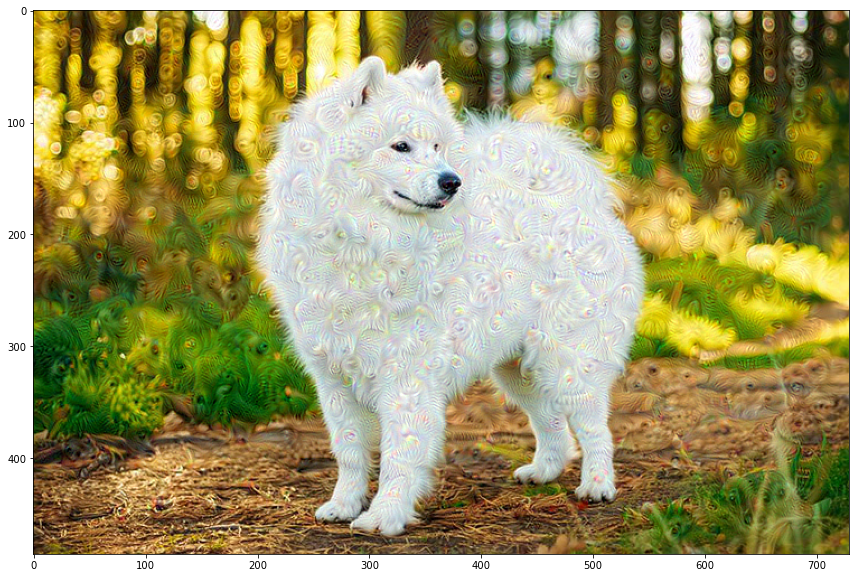

iteration 20


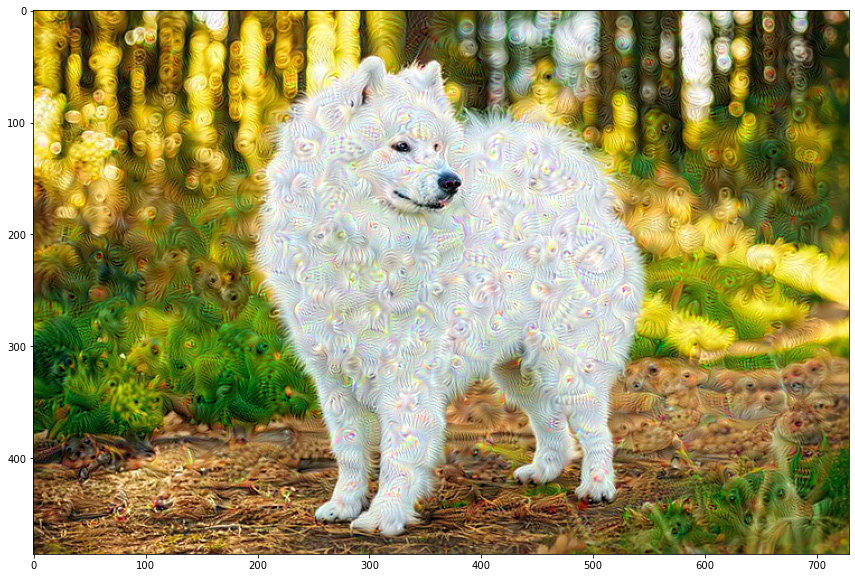

iteration 30


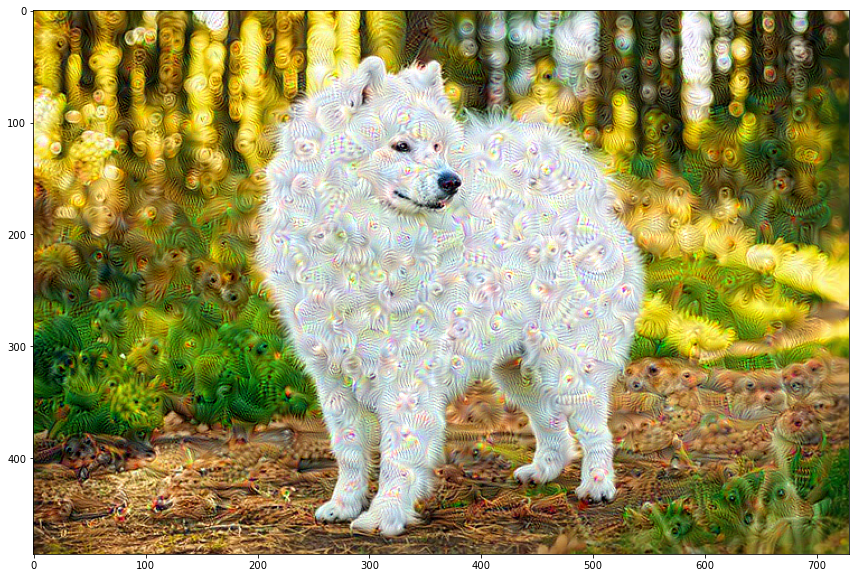

iteration 40


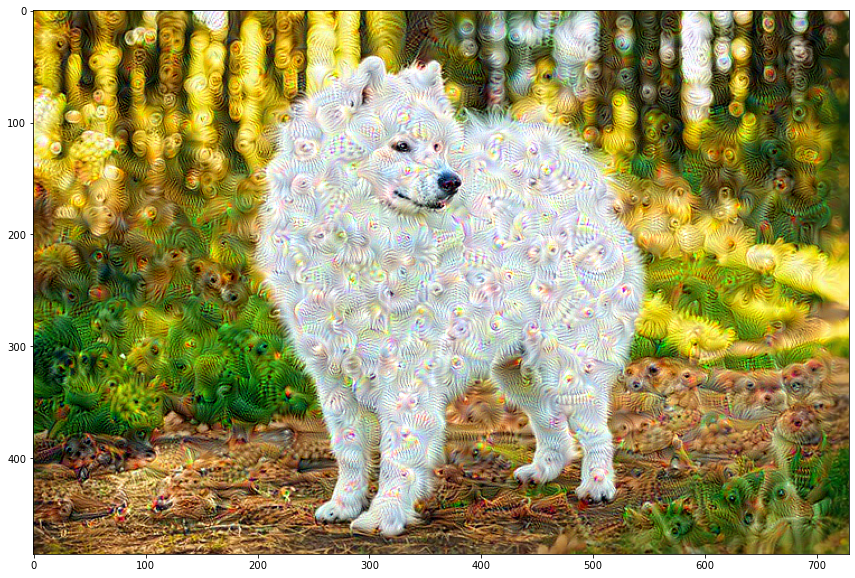

iteration 50


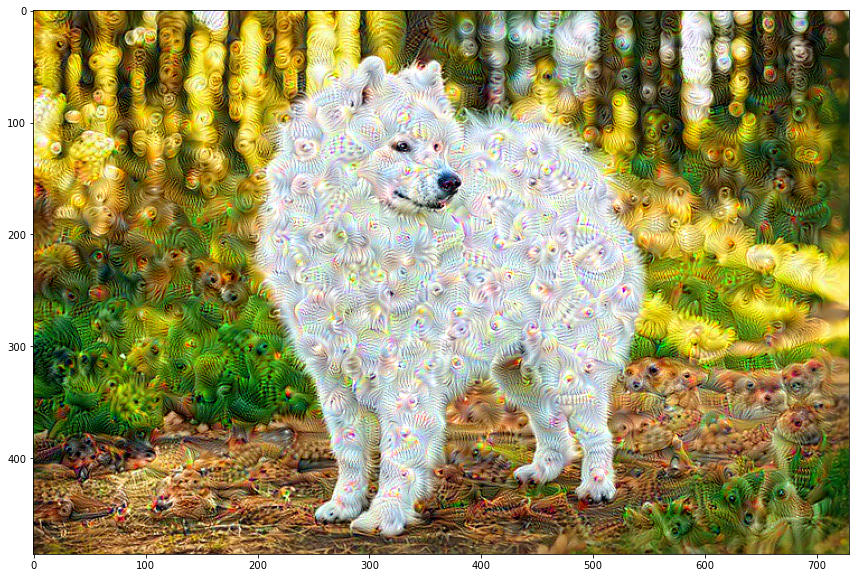

iteration 60


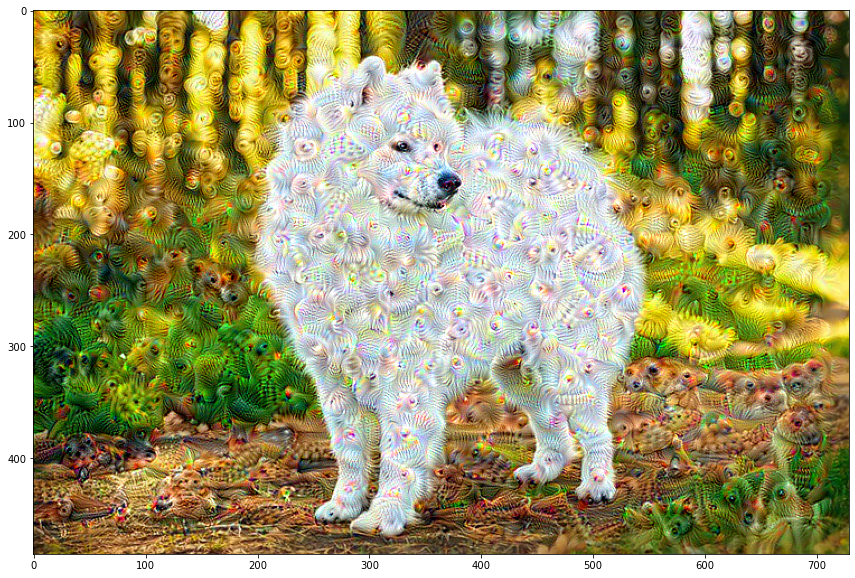

iteration 70


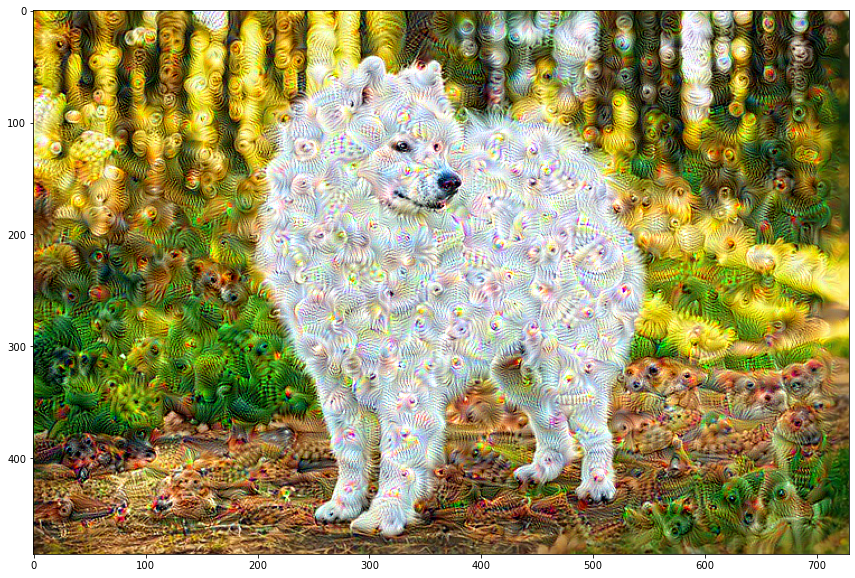

iteration 80


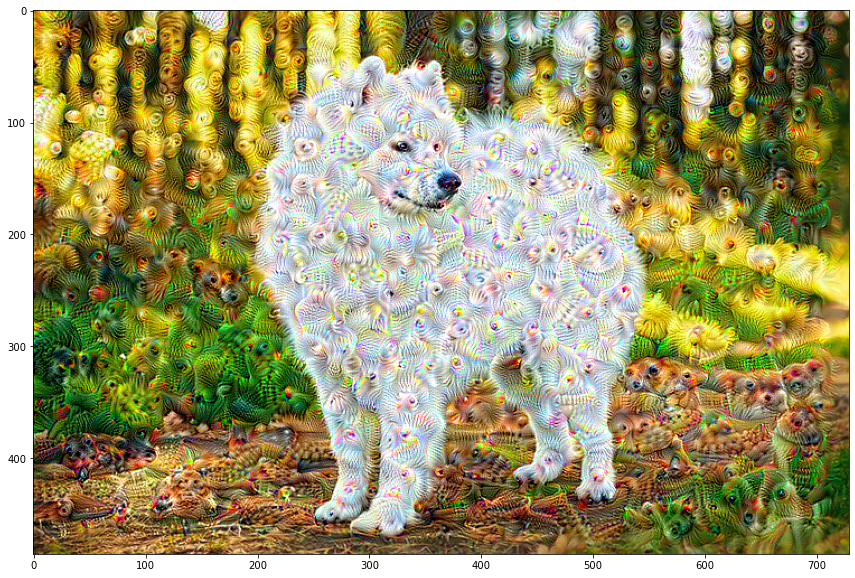

iteration 90


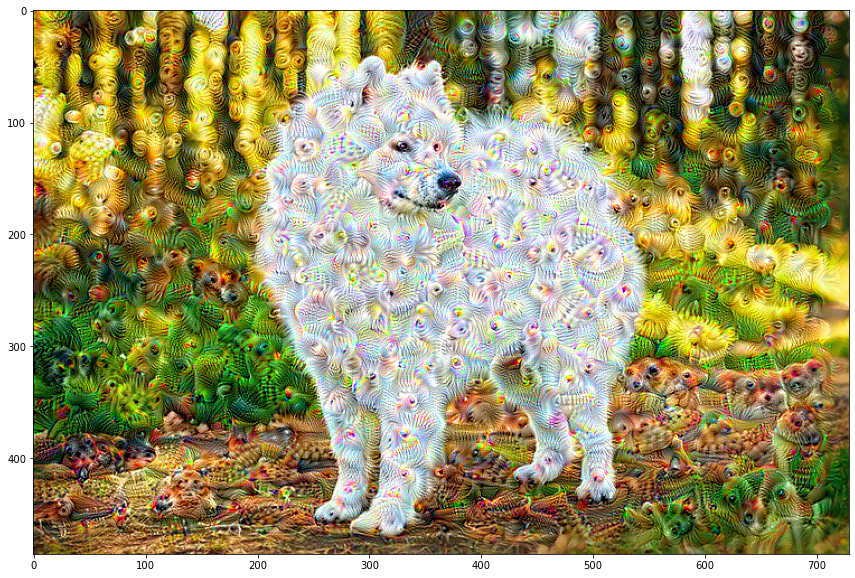

iteration 0


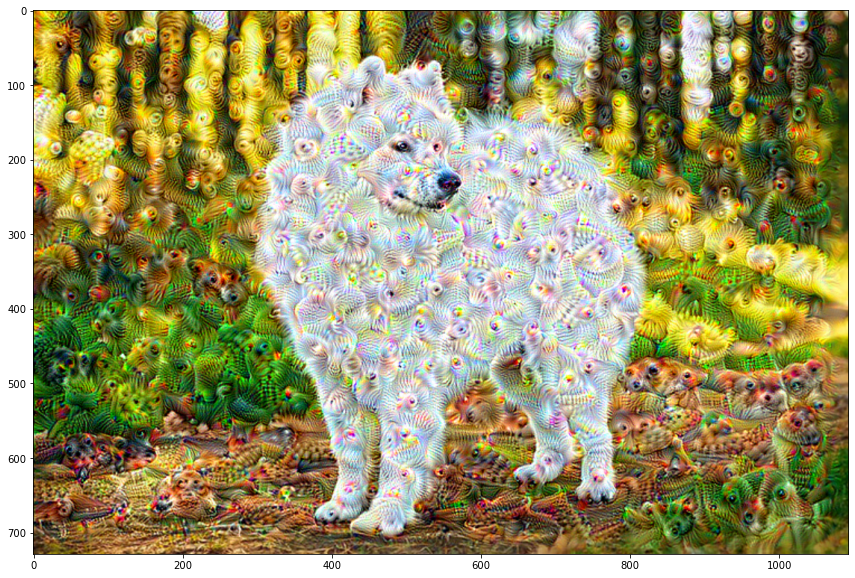

iteration 10


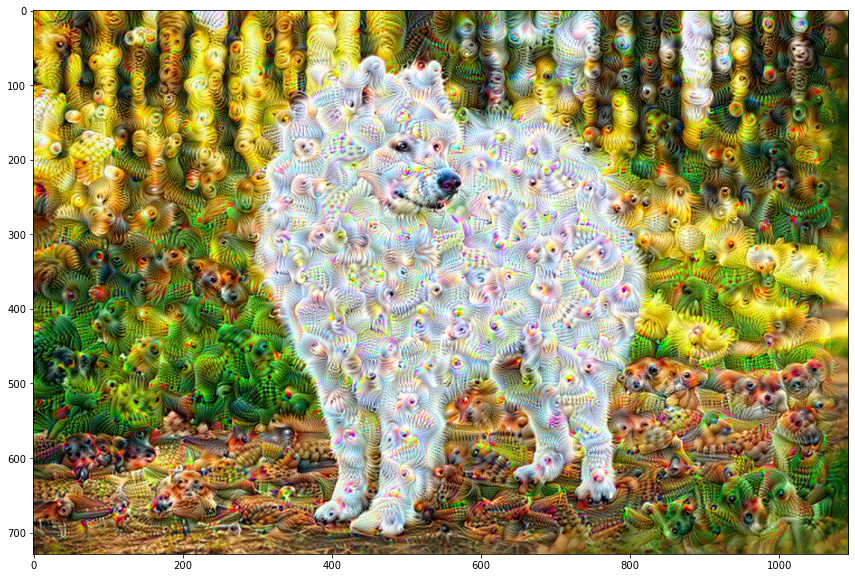

iteration 20


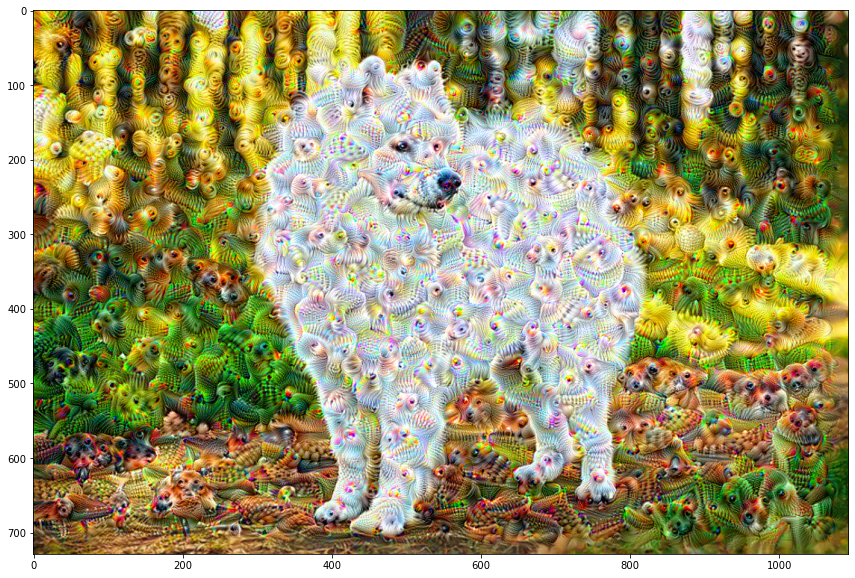

iteration 30


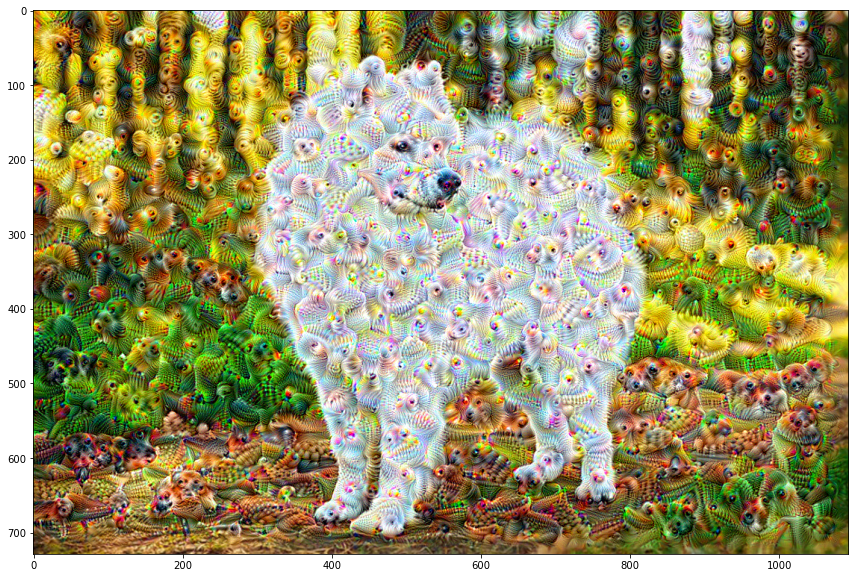

iteration 40


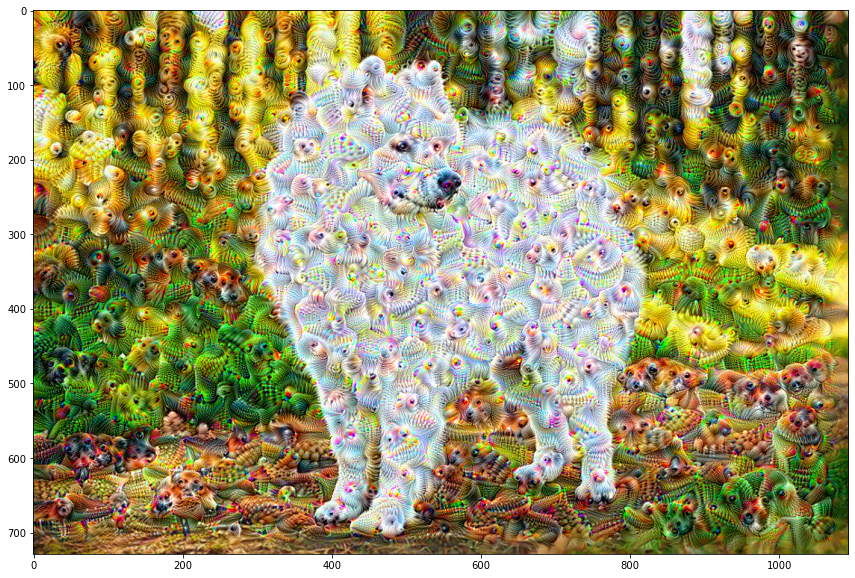

iteration 50


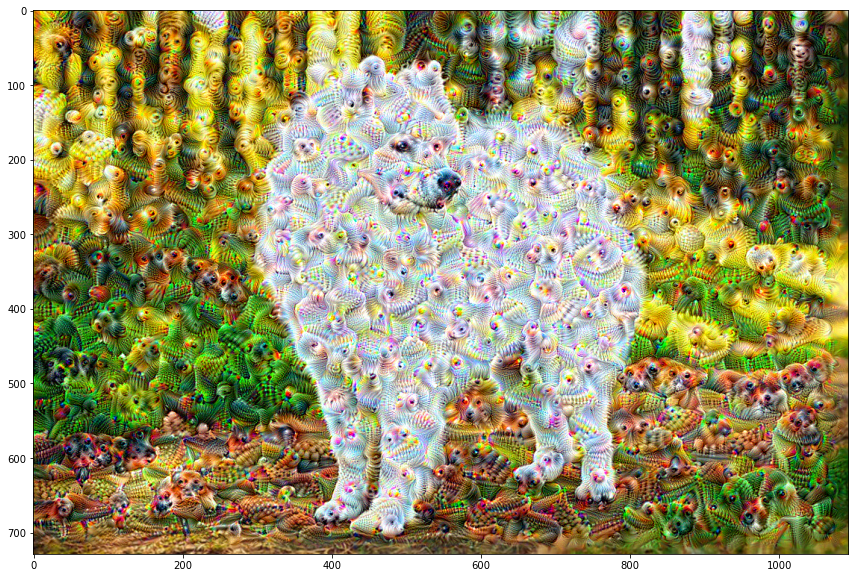

iteration 60


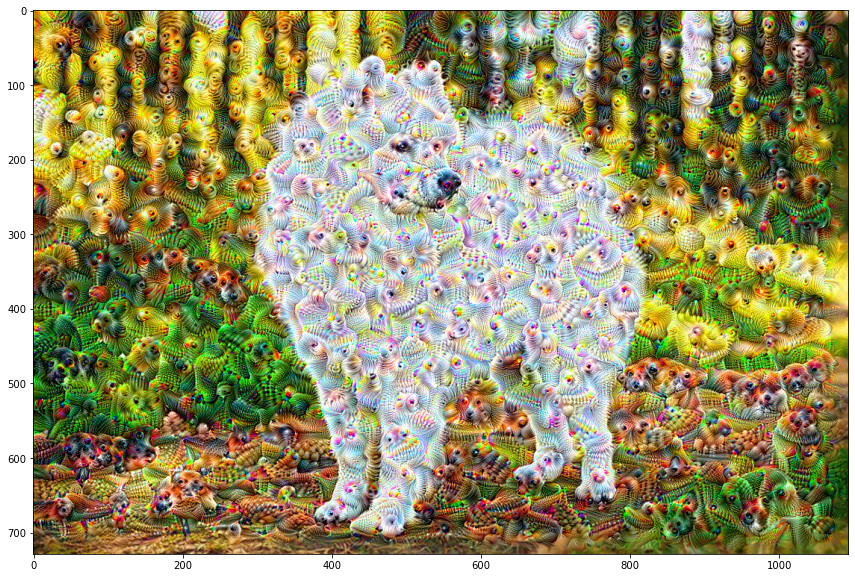

iteration 70


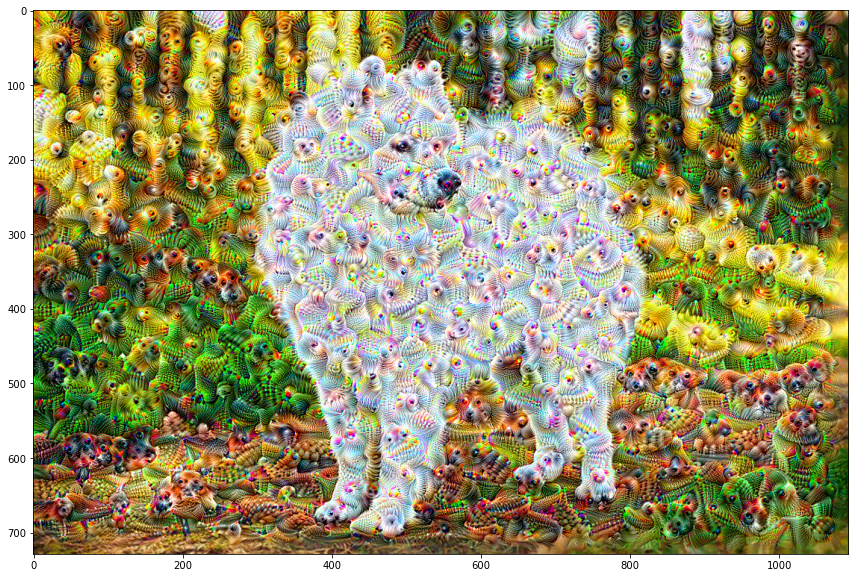

iteration 80


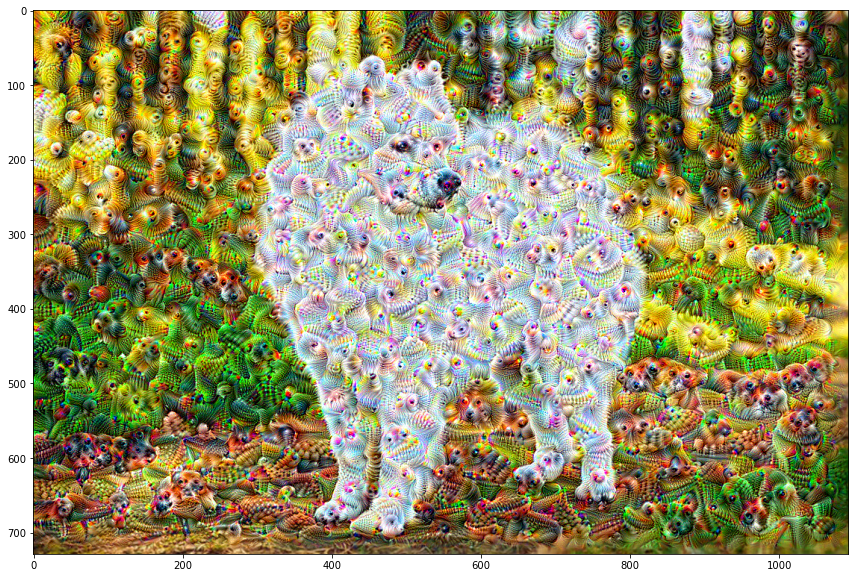

iteration 90


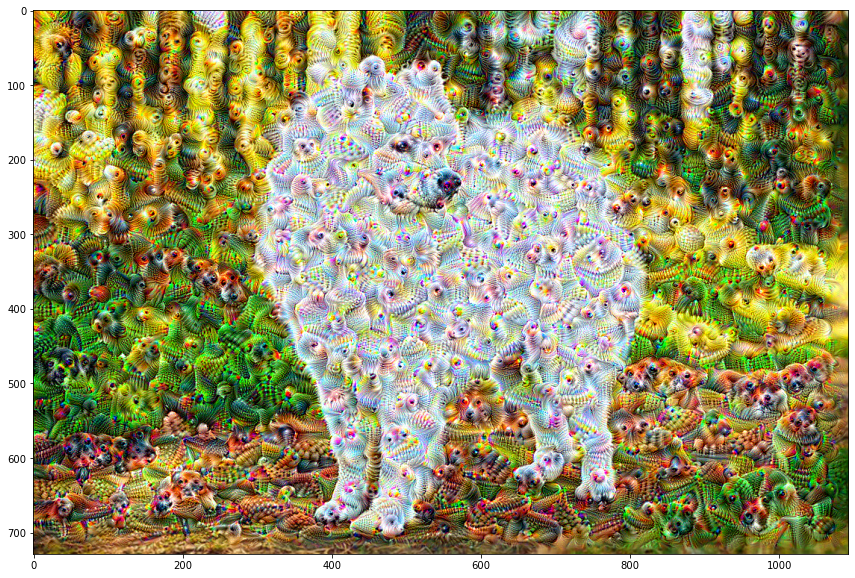

iteration 0


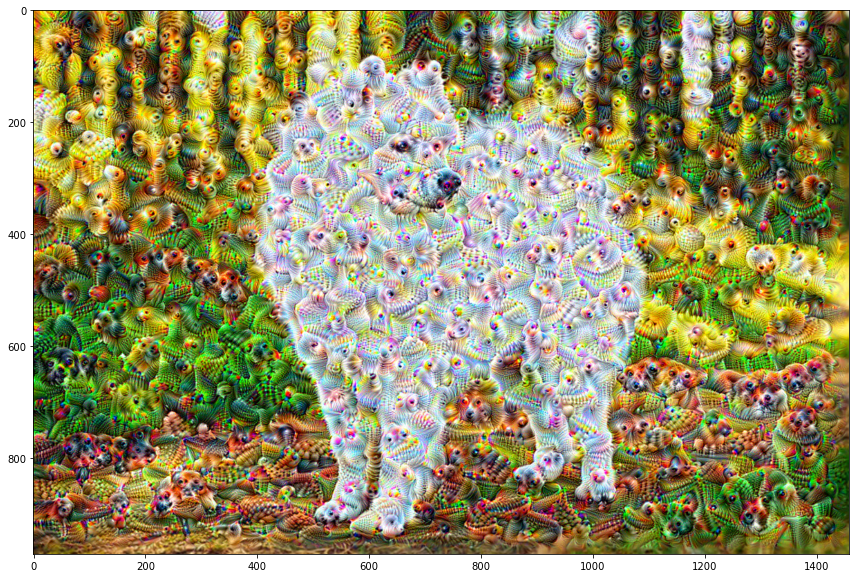

KeyboardInterrupt: 

In [4]:
if "png" not in PATH : img = mpimg.imread(PATH) / 255
else : img = mpimg.imread(PATH)[:, :, : 3]
    
tf_img = tf.convert_to_tensor(img, dtype = tf.float32)

# reshape image to get 4 dimensions 
curr_shape = tf.shape(tf_img).numpy()
new_shape = np.insert(curr_shape, 0, 1)

tf_img = tf.reshape(tf_img, new_shape)

# let's use a smaller resolution for faster results
#new_shape[1], new_shape[2] = int(new_shape[1] / 2), int(new_shape[2] / 2) 
#tf_img = tf.image.resize(tf_img, new_shape[1 : 3])

plot_img(tf_img.numpy()[0, :, :, :])

# variable shape of the image 
shape = new_shape.copy()
for k in [1, 1.5, 2, 2.5, 3] : 
    shape[1 : 3] = new_shape[1 : 3] * k
    
    # get back to shape expressed in integers
    shape = np.array(shape, dtype = int)
    resized_img = tf.image.resize(tf_img, shape[1 : 3])
    tf_img = deep_dream(resized_img, 100, 10, model, lr = .01)
    
# resize image to original size 
tf_img = tf.image.resize(tf_img, new_shape[1 : 3])


In [ ]:
for k, layer in enumerate(base_model.layers) : 
    print(k, layer.name)